#1.Soustraction entre frames successives

Début de la détection du mouvement (méthode t-1)

 Frame 50
Vidéo originale :


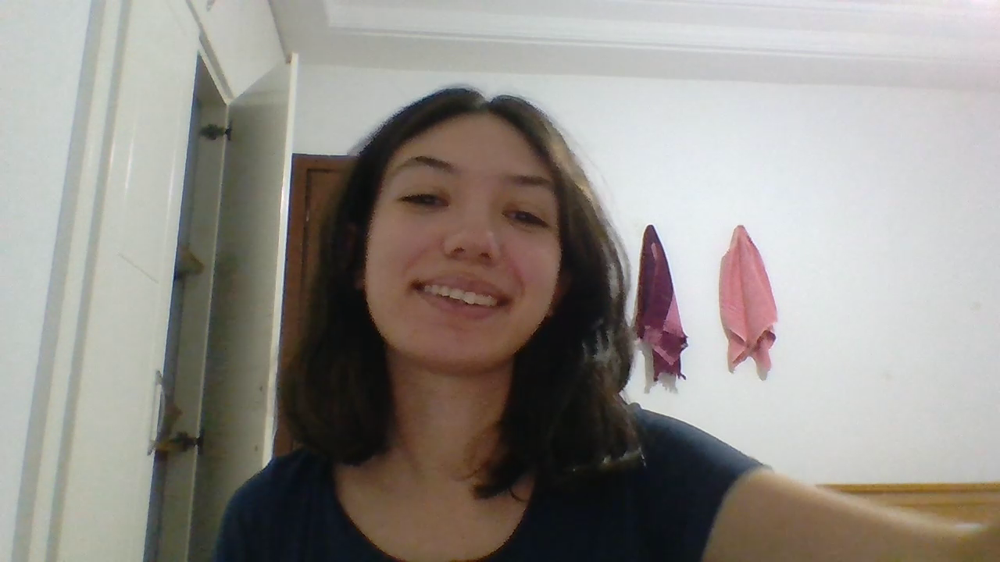

Différence t-1 (zones en mouvement détectées) :


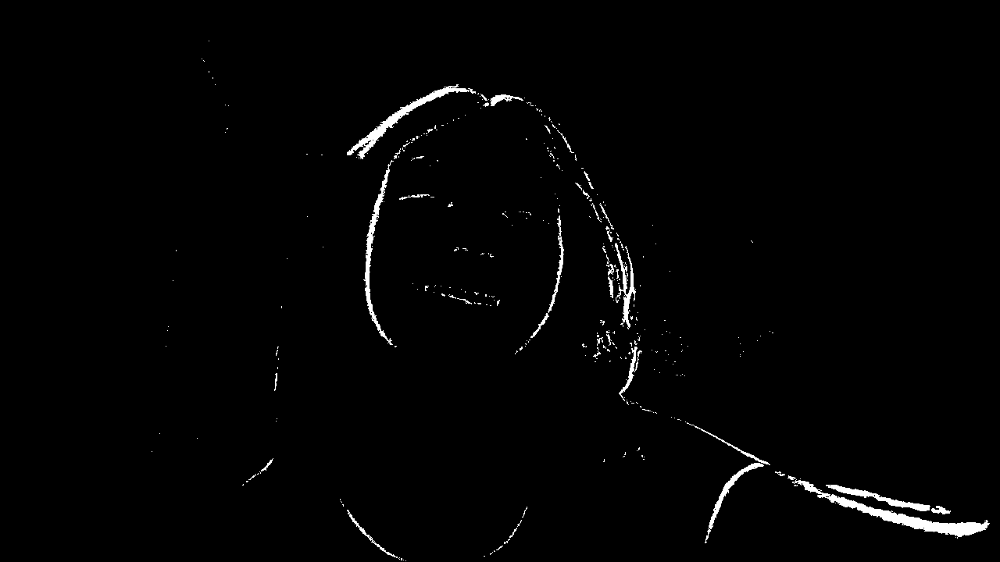


 Frame 100
Vidéo originale :


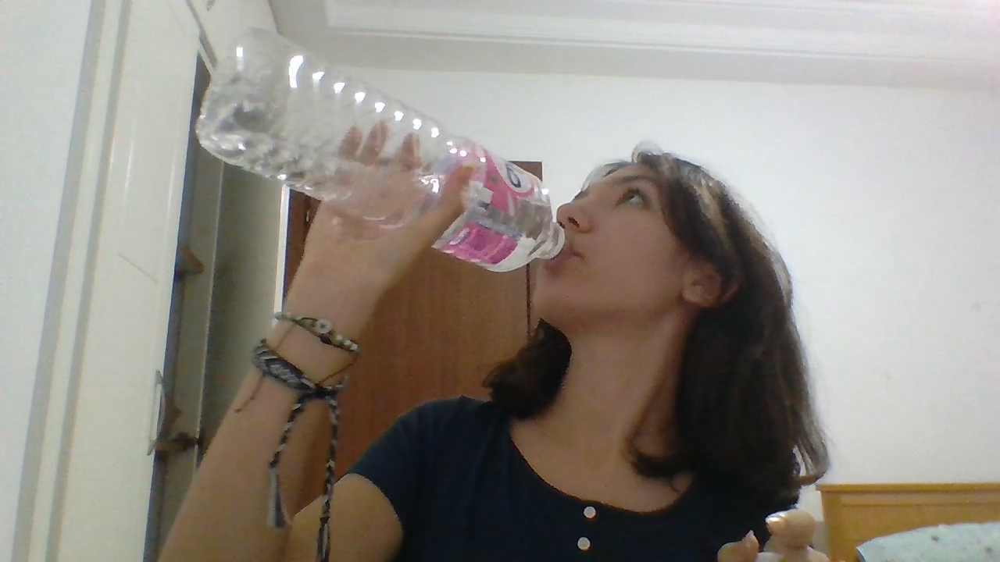

Différence t-1 (zones en mouvement détectées) :


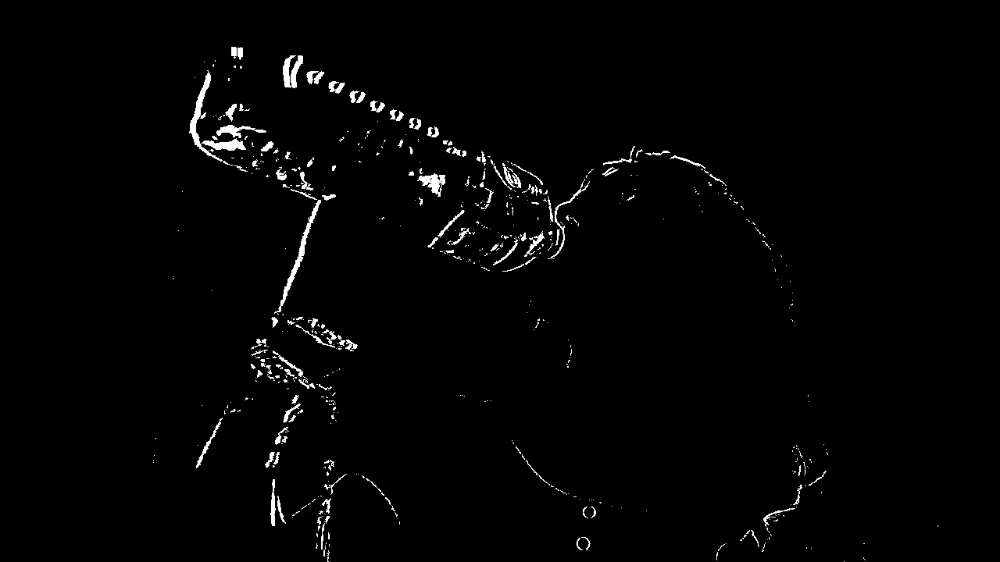


 Frame 150
Vidéo originale :


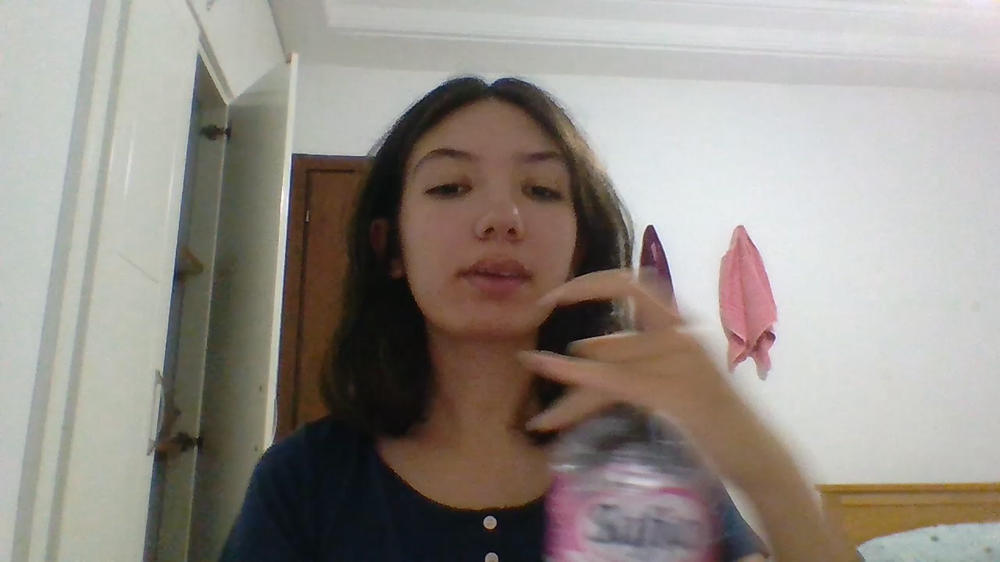

Différence t-1 (zones en mouvement détectées) :


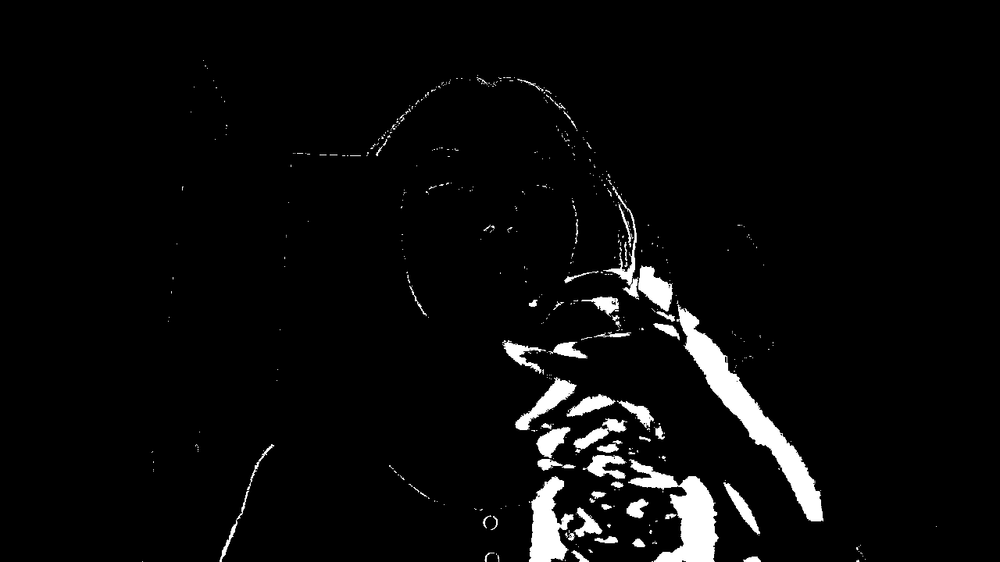


 Frame 200
Vidéo originale :


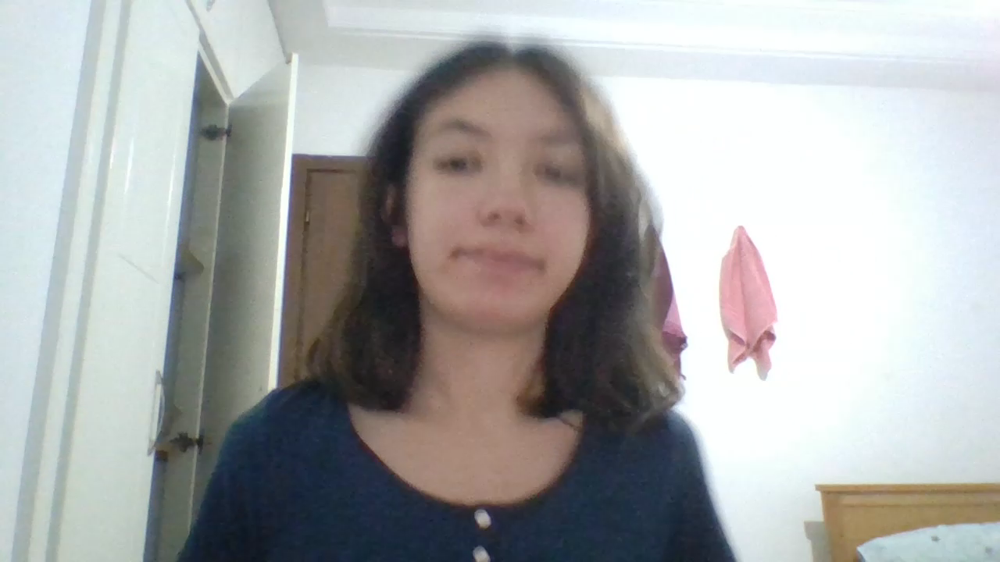

Différence t-1 (zones en mouvement détectées) :


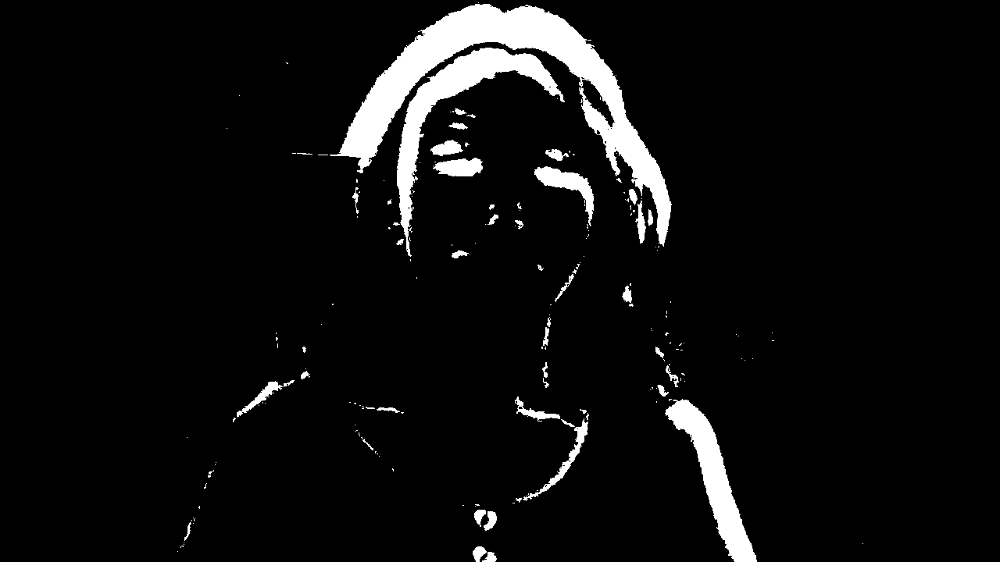


 Méthode de soustraction t-1 terminée.


In [2]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

#Chargement de la vidéo
video_path = "/content/sample_data/my_video.mp4"
video = cv2.VideoCapture(video_path)

# Lecture de la première frame (image t-1)
ret, frame = video.read()
if not ret:
    print("Erreur : impossible de lire la vidéo.")
    exit()

# Conversion en niveaux de gris
prev_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
frame_number = 1

print("Début de la détection du mouvement (méthode t-1)")

#Boucle sur toutes les frames suivantes
while True:
    ret, frame = video.read()
    if not ret:
        break

    # Conversion en niveaux de gris
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    #Soustraction absolue entre frames successives
    diff = cv2.absdiff(prev_gray, gray)

    #Seuillage pour ne garder que les différences significatives
    _, diff_thresh = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)

    # Affichage d’une frame toutes les 50 images
    if frame_number % 50 == 0:
        print(f"\n Frame {frame_number}")
        print("Vidéo originale :")
        cv2_imshow(frame)

        print("Différence t-1 (zones en mouvement détectées) :")
        cv2_imshow(diff_thresh)

    # Mise à jour de l’image précédente
    prev_gray = gray
    frame_number += 1

video.release()
print("\n Méthode de soustraction t-1 terminée.")


#2.Différenciation sur N frames (D(N))


228 frames chargées


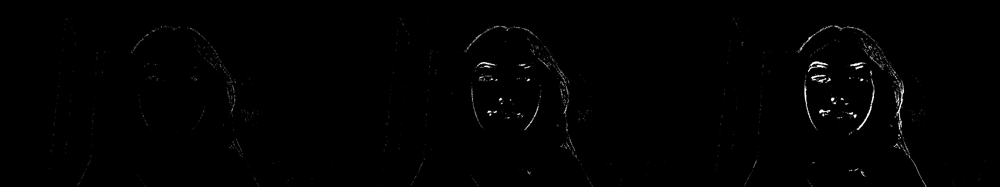

Frame 0 → Comparatif N = [1, 3, 5]


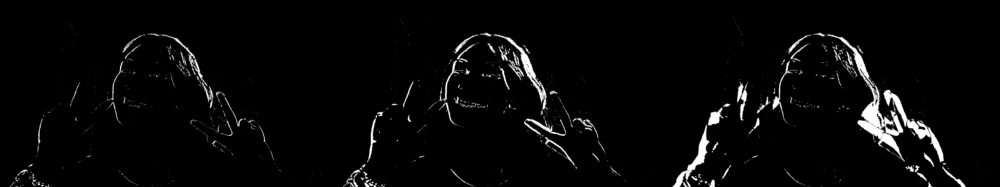

Frame 25 → Comparatif N = [1, 3, 5]


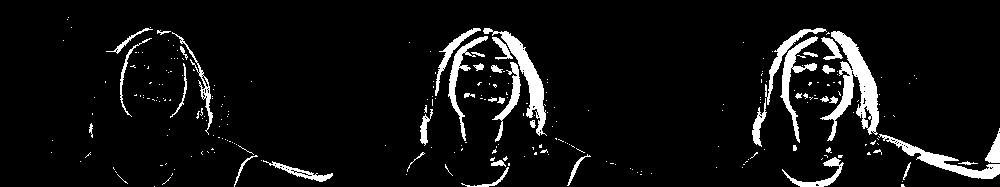

Frame 50 → Comparatif N = [1, 3, 5]


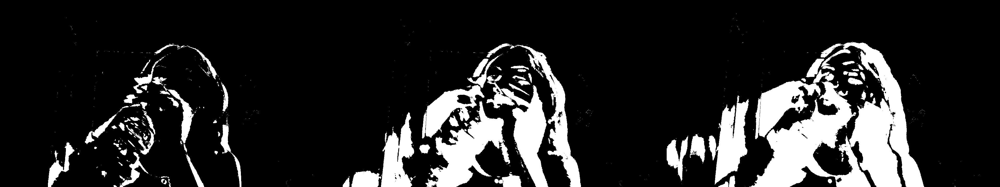

Frame 75 → Comparatif N = [1, 3, 5]


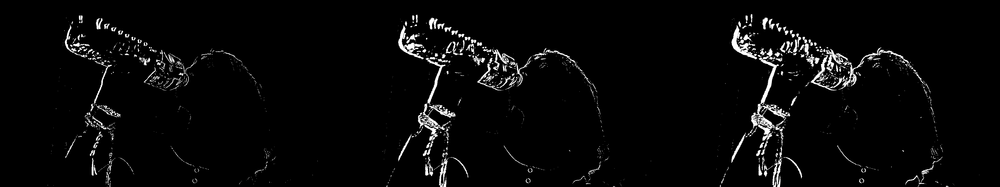

Frame 100 → Comparatif N = [1, 3, 5]


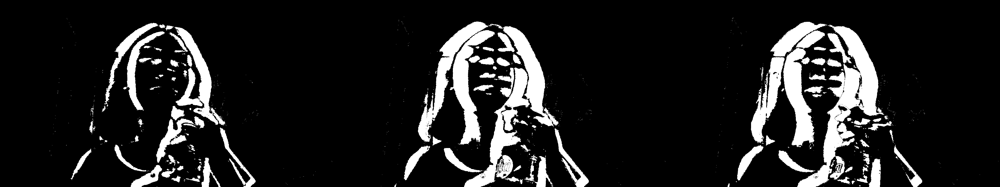

Frame 125 → Comparatif N = [1, 3, 5]


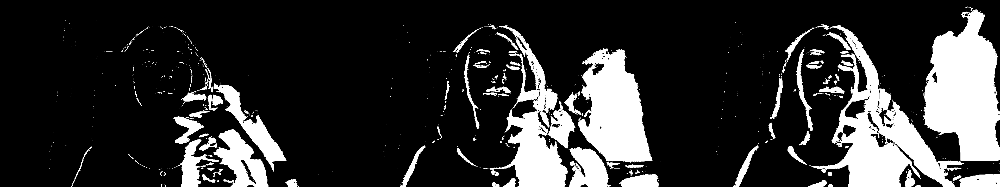

Frame 150 → Comparatif N = [1, 3, 5]


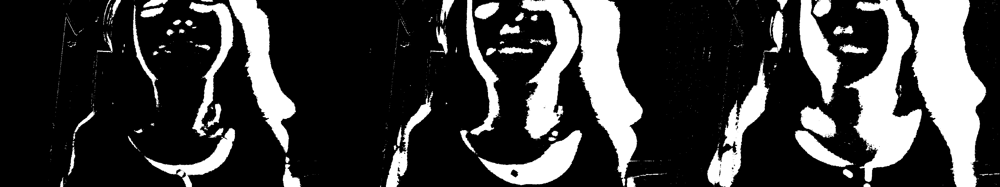

Frame 175 → Comparatif N = [1, 3, 5]


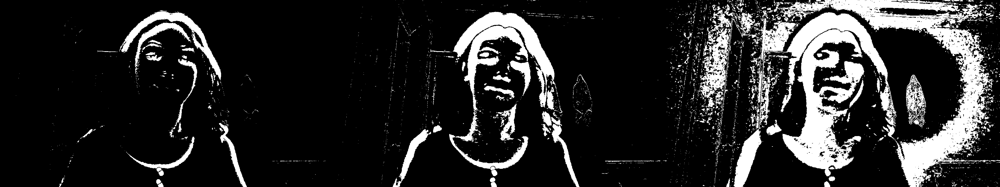

Frame 200 → Comparatif N = [1, 3, 5]


In [13]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Chargement de la vidéo
cap = cv2.VideoCapture('/content/sample_data/my_video.mp4')

# Lire toutes les frames en niveaux de gris
frames = []
while True:
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

cap.release()
print(f"{len(frames)} frames chargées")

# Paramètres
Ns = [1, 3, 5]  # valeurs de N à comparer
display_interval = 25  # afficher une frame toutes les 50 frames

#Boucle sur les frames pour créer le comparatif
for i in range(len(frames) - max(Ns)):
    if i % display_interval != 0:
        continue  # afficher seulement une frame sur X

    diff_images = []
    for N in Ns:
        diff = cv2.absdiff(frames[i], frames[i + N])
        _, thresh = cv2.threshold(diff, 25, 255, cv2.THRESH_BINARY)
        # Convertir en 3 canaux pour concaténation couleur
        thresh_color = cv2.cvtColor(thresh, cv2.COLOR_GRAY2BGR)
        diff_images.append(thresh_color)

    # Combiner toutes les images côte à côte
    combined = np.hstack(diff_images)
    cv2_imshow(combined)

    # Légende pour Colab
    print(f"Frame {i} → Comparatif N = {Ns}")


#3.Adaptive Background Substruction



Frame 0 → Comparatif α = [0.01, 0.05, 0.1]


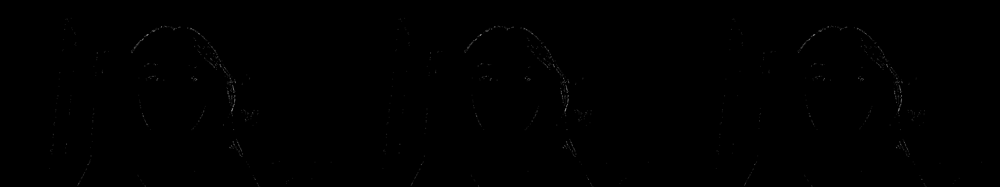


Frame 50 → Comparatif α = [0.01, 0.05, 0.1]


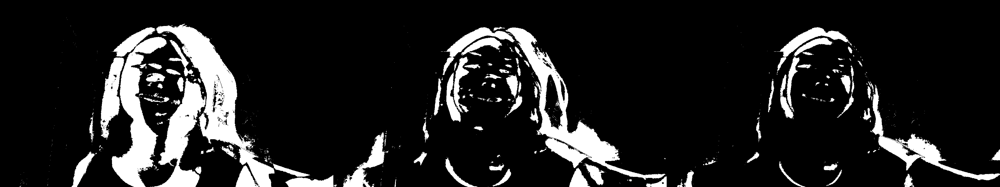


Frame 100 → Comparatif α = [0.01, 0.05, 0.1]


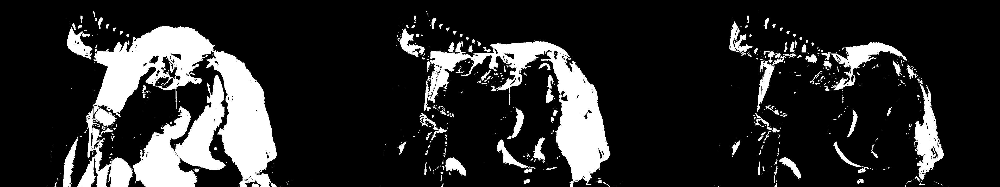


Frame 150 → Comparatif α = [0.01, 0.05, 0.1]


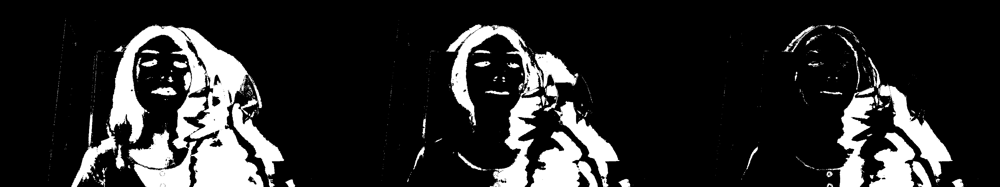


Frame 200 → Comparatif α = [0.01, 0.05, 0.1]


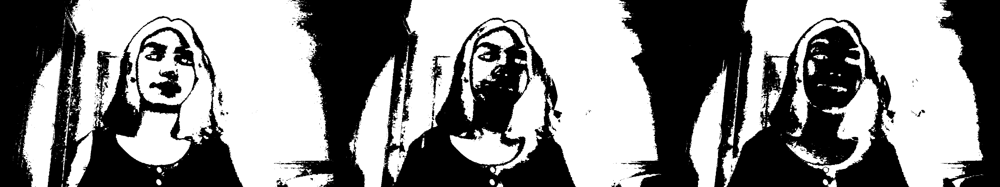


 Adaptive Background Subtraction terminée


In [7]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Chargement de la vidéo
cap = cv2.VideoCapture('/content/sample_data/my_video.mp4')

# Lecture de la première frame pour initialiser le fond
ret, frame = cap.read()
if not ret:
    print("Erreur : impossible de lire la vidéo.")
    exit()

background_init = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY).astype(float)

# Paramètres
alphas = [0.01, 0.05, 0.1]  # différents α à tester
display_interval = 50  # afficher une frame sur 50

#Initialisation des fonds adaptatifs pour chaque alpha
backgrounds = [background_init.copy() for _ in alphas]

frame_number = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY).astype(float)
    diff_images = []

    for idx, alpha in enumerate(alphas):
        #Mise à jour du fond adaptatif
        backgrounds[idx] = alpha * gray + (1 - alpha) * backgrounds[idx]

        #Calcul de la différence
        diff = cv2.absdiff(gray, backgrounds[idx])
        _, thresh = cv2.threshold(diff.astype(np.uint8), 25, 255, cv2.THRESH_BINARY)

        # Convertir en 3 canaux pour affichage côte à côte
        diff_color = cv2.cvtColor(thresh, cv2.COLOR_GRAY2BGR)
        diff_images.append(diff_color)

    # Affichage
    if frame_number % display_interval == 0:
        combined = np.hstack(diff_images)
        print(f"\nFrame {frame_number} → Comparatif α = {alphas}")
        cv2_imshow(combined)

    frame_number += 1

cap.release()
print("\n Adaptive Background Subtraction terminée")


#4.Méthodes OpenCV de soustraction de fond

#4-1.MOG2 Background Subtraction

Frame 0 — Vidéo originale vs MOG2


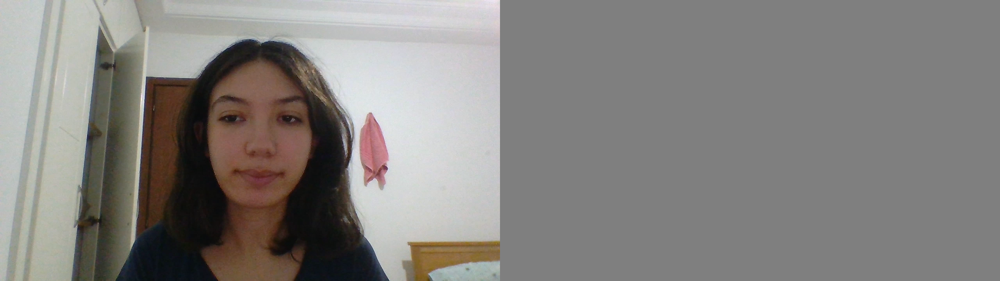

Frame 50 — Vidéo originale vs MOG2


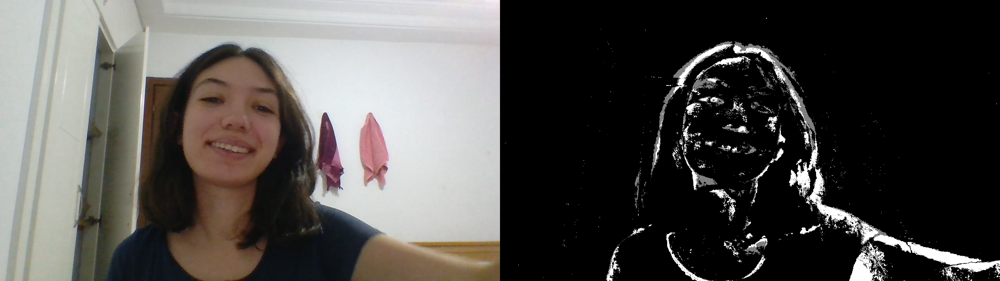

Frame 100 — Vidéo originale vs MOG2


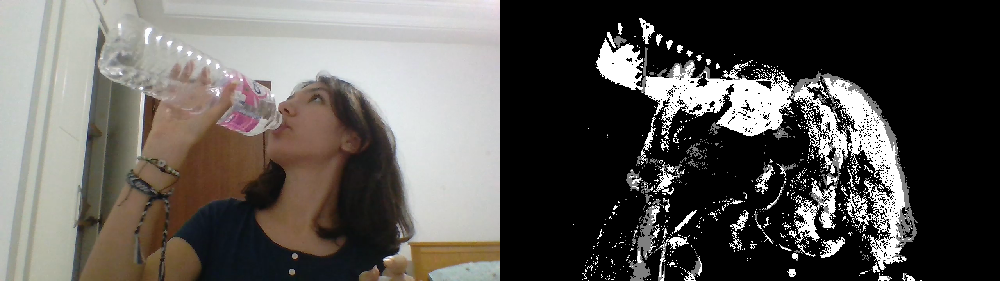

Frame 150 — Vidéo originale vs MOG2


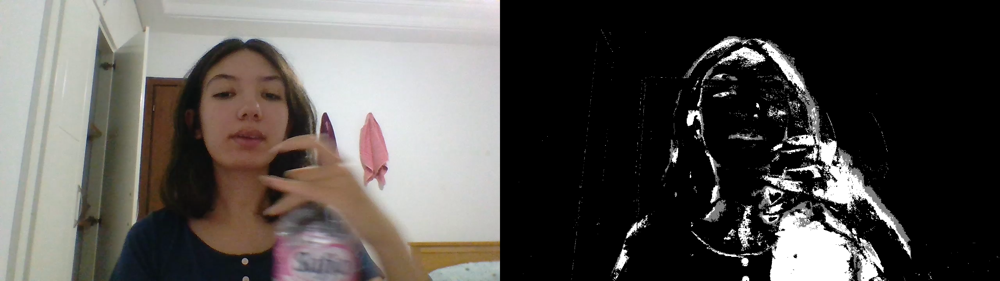

Frame 200 — Vidéo originale vs MOG2


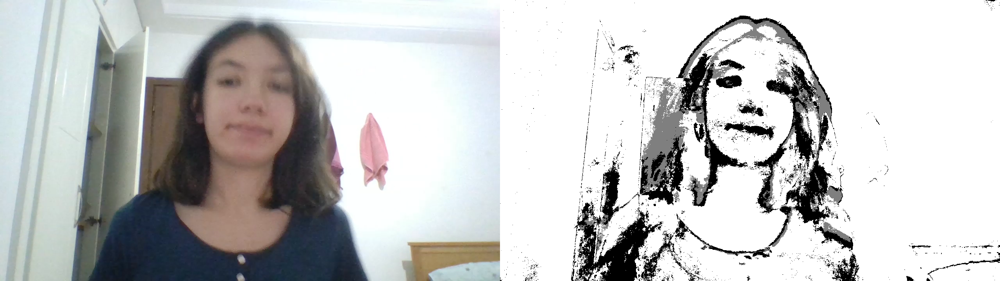

 MOG2 Background Subtraction terminée


In [14]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

#Chargement de la vidéo
video_path = "/content/sample_data/my_video.mp4"
cap = cv2.VideoCapture(video_path)

#Création du soustracteur de fond MOG2
fgbg = cv2.createBackgroundSubtractorMOG2(detectShadows=True)

frame_number = 0
display_interval = 50  # afficher une frame sur 50

while True:
    ret, frame = cap.read()
    if not ret:
        break

    #Calcul du masque de foreground
    fgmask = fgbg.apply(frame)

    #Affichage toutes les 50 frames
    if frame_number % display_interval == 0:
        # Convertir le masque en 3 canaux pour concaténation
        fgmask_color = cv2.cvtColor(fgmask, cv2.COLOR_GRAY2BGR)
        combined = np.hstack((frame, fgmask_color))
        print(f"Frame {frame_number} — Vidéo originale vs MOG2")
        cv2_imshow(combined)

    frame_number += 1

cap.release()
print(" MOG2 Background Subtraction terminée")


# 4-2.KNN Background Subtraction

Frame 0 — Vidéo originale vs KNN


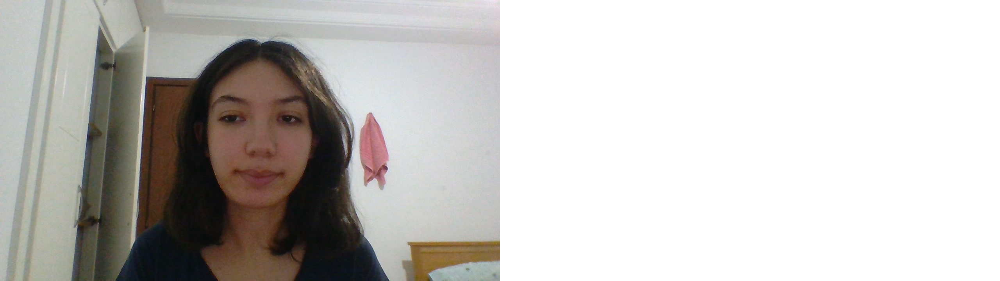

Frame 50 — Vidéo originale vs KNN


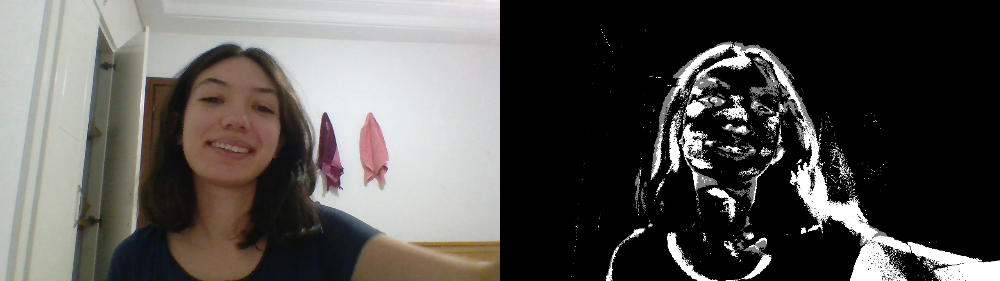

Frame 100 — Vidéo originale vs KNN


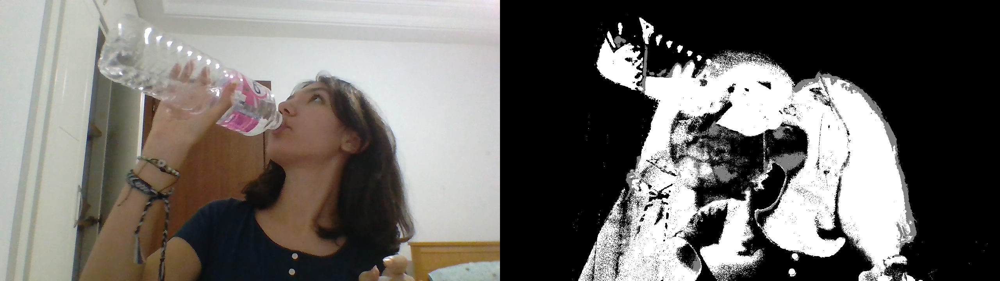

Frame 150 — Vidéo originale vs KNN


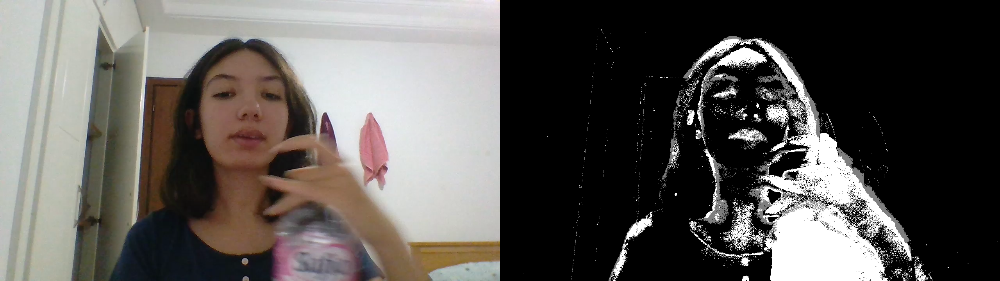

Frame 200 — Vidéo originale vs KNN


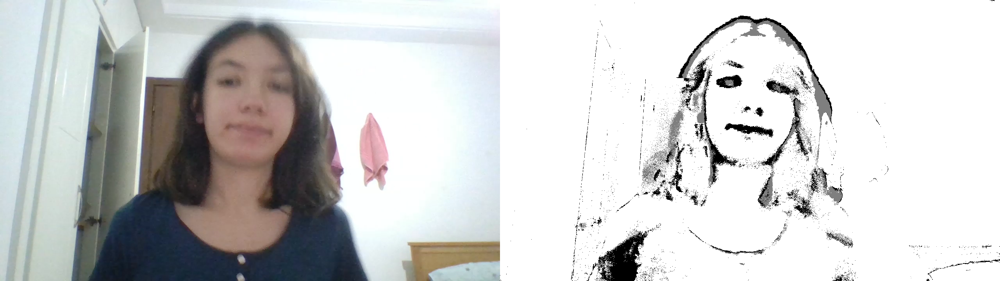

KNN Background Subtraction terminée


In [12]:
import cv2
from google.colab.patches import cv2_imshow

#Chargement de la vidéo
video_path = "/content/sample_data/my_video.mp4"
cap = cv2.VideoCapture(video_path)

#Création du soustracteur de fond KNN
fgknn = cv2.createBackgroundSubtractorKNN(detectShadows=True)

frame_number = 0
display_interval = 50  # afficher une frame sur 50

while True:
    ret, frame = cap.read()
    if not ret:
        break

    #Calcul du masque de foreground
    fgmask = fgknn.apply(frame)

    #Affichage  toutes les 50 frames
    if frame_number % display_interval == 0:
        # Convertir le masque en 3 canaux pour concaténation
        fgmask_color = cv2.cvtColor(fgmask, cv2.COLOR_GRAY2BGR)
        combined = np.hstack((frame, fgmask_color))
        print(f"Frame {frame_number} — Vidéo originale vs KNN")
        cv2_imshow(combined)

    frame_number += 1

cap.release()
print("KNN Background Subtraction terminée")
